# Conditional Diffusion Model: A Pytorch Implementation

Denoising Diffusion Probabilistic Models (DDPMs) are generative models that utilize forward and reverse noising processes. Recently, diffusion models have been applied to image compression tasks by incorporating conditionals into a denoising decoder.

In this notebook, I implement a fundamental principle of conditional diffusion models as presented in _Lossy Image Compression with Conditional Diffusion Models_ (https://proceedings.neurips.cc/paper_files/paper/2023/file/ccf6d8b4a1fe9d9c8192f00c713872ea-Paper-Conference.pdf). The Fashion-MNIST dataset is used in this tutorial.

# Author
**Jaemoon Lee**
[LinkedIn](https://www.linkedin.com/in/jaemoon-lee-phd/)

# Package
The **einops** package is needed for a GIF animation in this tutorial.

In [ ]:
!pip3 install --upgrade pip
!pip3 install einops

# Imports

In [60]:
# Import of libraries
import numpy as np
import math
import os
from argparse import ArgumentParser
import random
import imageio
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

import einops
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader

from torchvision.transforms import Compose, ToTensor, Lambda
from torchvision.datasets.mnist import MNIST, FashionMNIST

# Setting reproducibility
SEED = 0
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

# Definitions
#STORE_PATH_MNIST = f"ddpm_model_mnist.pt"
#STORE_PATH_FASHION = f"ddpm_model_fashion.pt"

# Parameter setting
- `train_flag`: setting **True** if you want to train a new model.
- `batch_size`, `n_epochs`, and `lr` are hyper-parameters for training.

In [2]:
train_flag = True
batch_size = 128
n_epochs = 20
lr = 0.001

In [3]:
dirname = '../model/'
os.makedirs(os.path.dirname(dirname), exist_ok=True)

In [4]:
model_store_name = "conditional_ddpm"

# Displaying images
- `show_images` displays input images in a square form.
- `show_first_batch` displays the images in the first batch of a Data Loader object.

In [5]:
def show_images(images, title=""):
    """Shows the provided images as sub-pictures in a square"""

    # Converting images to CPU numpy arrays
    if type(images) is torch.Tensor:
        images = images.detach().cpu().numpy()

    # Defining number of rows and columns
    fig = plt.figure(figsize=(8, 8))
    rows = int(len(images) ** (1 / 2))
    cols = round(len(images) / rows)

    # Populating figure with sub-plots
    idx = 0
    for r in range(rows):
        for c in range(cols):
            fig.add_subplot(rows, cols, idx + 1)

            if idx < len(images):
                plt.imshow(images[idx][0], cmap="gray")
                idx += 1
    fig.suptitle(title, fontsize=30)

    # Showing the figure
    plt.show()

In [30]:
def show_first_batch(loader, title="Images in the first batch"):
    for batch in loader:
        show_images(batch[0], title)
        break

# Data preparation and getting device
We will use Fashion-MNIST dataset. **Note**: We need to normalize each image in range `[-1,1]` as the denoising process is based on normal distribution.
Also, we will prepare both training and test sets to evaluate compression quality. For the final evaluation, we don't shuffle the data in `eval_train_loader` and `eval_test_loader`.

In [7]:
# Loading the data (converting each image into a tensor and normalizing between [-1, 1])
transform = Compose([
    ToTensor(),
    Lambda(lambda x: (x - 0.5) * 2)]
)
ds_fn = FashionMNIST
dataset = ds_fn("./datasets", download=True, train=True, transform=transform)

In [8]:
train_loader = DataLoader(dataset, batch_size, shuffle=True)
eval_train_loader = DataLoader(dataset, batch_size, shuffle=False)

In [9]:
test_dataset = ds_fn("./datasets", download=True, train=False, transform=transform)
eval_test_loader = DataLoader(test_dataset, batch_size, shuffle=False)

In [10]:
train_num = len(dataset)
test_num = len(test_dataset)
print('Number of images in training set: ', train_num)
print('Number of images in test set: ', test_num)

Number of images in training set:  60000
Number of images in test set:  10000


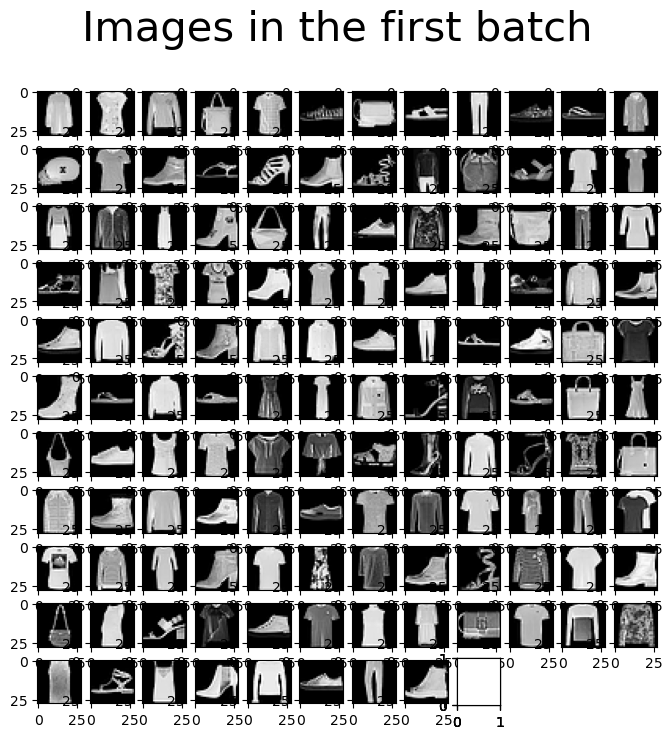

In [31]:
# Option: showing the first batch of training data loader
show_first_batch(train_loader)

In [12]:
# Getting device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}\t" + (f"{torch.cuda.get_device_name(0)}" if torch.cuda.is_available() else "CPU"))

Using device: cuda	NVIDIA GeForce RTX 4090


# Setting up the DDPM model

We now proceed and define a DDPM PyTorch module. Since in principle the DDPM scheme is independent of the model architecture used in each denoising step, we define a high-level model that is constructed using a `network` parameter, as well as:
- `n_steps`: number of diffusion steps $T$.
- `min_beta`, `max_beta`: values of the first $\beta_t$($\beta_1$) and the last $\beta_t$($\beta_T$).
- `image_chw`: tuple contining dimensionality of images.

In the forward process, we use $\{\bar{\alpha}_t\}$ that is pre-defined by $\{\beta_t\}$ with $\alpha_t=1-\beta_t$ and $\bar{\alpha}_t=\prod_{i=1}^{T}\alpha_i$. Therefore, there is no learning in the forward process and we can directly obtain the noisy image at time step $t$.

The `backward` implements the reverse process, where the network predicts noises at $t$. The original tensor ``x0`` is used to produce **embeddings** that guide the denoising diffusion process.

`t` is used for time-embeddings and is assumed to be a `(N,1)` tensor, where `N` is the number of images in a tensor `x`.

In [13]:
# DDPM class
class Cond_DDPM(nn.Module):
    def __init__(self, network, n_steps=1000, min_beta=10 ** -4, max_beta=0.02, device=None, image_chw=(1, 28, 28)):
        super(Cond_DDPM, self).__init__()
        self.n_steps = n_steps
        self.device = device
        self.image_chw = image_chw
        self.network = network.to(device)
        self.betas = torch.linspace(min_beta, max_beta, n_steps).to(device)
        self.alphas = 1 - self.betas
        self.alpha_bars = torch.tensor([torch.prod(self.alphas[:i + 1]) for i in range(len(self.alphas))]).to(device)

    def forward(self, x0, t, eta=None):
        # Forward diffusion process
        n, c, h, w = x0.shape
        a_bar = self.alpha_bars[t]

        if eta is None:
            eta = torch.randn(n, c, h, w).to(self.device)

        noisy = a_bar.sqrt().reshape(n, 1, 1, 1) * x0 + (1 - a_bar).sqrt().reshape(n, 1, 1, 1) * eta
        return noisy

    def backward(self, x, t, x0):
        # The network predicts noises added to images for each timestep t by using conditionals produced by x0.
        return self.network(x, t, x0)

# Displaying forward
- The `show_forward` function shows noisy images in the forward process across the diffusion time steps.

In [14]:
def show_forward(ddpm, loader, device):
    # Showing the forward process
    for batch in loader:
        imgs = batch[0]

        show_images(imgs, "Original images")

        for percent in [0.25, 0.5, 0.75, 1]:
            show_images(
                ddpm(imgs.to(device),
                     [int(percent * ddpm.n_steps) - 1 for _ in range(len(imgs))]),
                f"DDPM Noisy images {int(percent * 100)}%"
            )
        break

# U-Net architecture
`sinusoidal_embedding` generates embeddings of diffusion time steps.

The `denoising_UNet` consists of two parts:
- Conditional encoding and embedding units: `cd3` produces compressed codec and `cd3`, `cu1`, and `cu2` generate embeddings that are fed into U-Net downsampling units.
- The generated embeddings are concatenated in the downsampling layers of the U-Net as well as sinusoidal embeddings.

In [15]:
def sinusoidal_embedding(n, d):
    # Returns the standard positional embedding
    embedding = torch.zeros(n, d)
    wk = torch.tensor([1 / 10_000 ** (2 * j / d) for j in range(d)])
    wk = wk.reshape((1, d))
    t = torch.arange(n).reshape((n, 1))
    embedding[:,::2] = torch.sin(t * wk[:,::2])
    embedding[:,1::2] = torch.cos(t * wk[:,::2])

    return embedding

In [16]:
class NetBlock(nn.Module):
    def __init__(self, shape, in_c, out_c, kernel_size=3, stride=1, padding=1, activation=None, normalize=True):
        super(NetBlock, self).__init__()
        self.ln = nn.LayerNorm(shape)
        self.conv1 = nn.Conv2d(in_c, out_c, kernel_size, stride, padding)
        self.conv2 = nn.Conv2d(out_c, out_c, kernel_size, stride, padding)
        self.activation = nn.SiLU() if activation is None else activation
        self.normalize = normalize

    def forward(self, x):
        out = self.ln(x) if self.normalize else x
        out = self.conv1(out)
        out = self.activation(out)
        out = self.conv2(out)
        out = self.activation(out)
        return out

In [17]:
class denoising_UNet(nn.Module):
    def __init__(self, n_steps=1000, time_emb_dim=100):
        super(denoising_UNet, self).__init__()

        # Sinusoidal embedding
        self.time_embed = nn.Embedding(n_steps, time_emb_dim)
        self.time_embed.weight.data = sinusoidal_embedding(n_steps, time_emb_dim)
        self.time_embed.requires_grad_(False)

        # Conditional part
        self.cd1 = nn.Sequential(
            NetBlock((1, 28, 28), 1, 20),
            nn.Conv2d(20, 20, 4, 2, 1)
        )
        self.cd2 = nn.Sequential(
            NetBlock((20, 14, 14), 20, 40),
            nn.Conv2d(40, 40, 4, 2, 1)
        )
        self.cd3 = nn.Sequential(
            NetBlock((40, 7, 7), 40, 40) # 40ch
        )
        self.cu1 = nn.Sequential(
            nn.ConvTranspose2d(40, 40, 4, 2, 1),
            nn.SiLU(),
            NetBlock((40, 14, 14), 40, 40) # 40ch
        )
        self.cu2 = nn.Sequential(
            nn.ConvTranspose2d(40, 40, 4, 2, 1),
            nn.SiLU(),
            NetBlock((40, 28, 28), 40, 40) # 40ch
        )

        # First half
        self.te1 = self._make_te(time_emb_dim, 41)
        self.b1 = nn.Sequential(
            NetBlock((41, 28, 28), 41, 10),
            NetBlock((10, 28, 28), 10, 10),
            NetBlock((10, 28, 28), 10, 10)
        )
        self.down1 = nn.Conv2d(10, 10, 4, 2, 1)

        self.te2 = self._make_te(time_emb_dim, 50)
        self.b2 = nn.Sequential(
            NetBlock((50, 14, 14), 50, 20),
            NetBlock((20, 14, 14), 20, 20),
            NetBlock((20, 14, 14), 20, 20)
        )
        self.down2 = nn.Conv2d(20, 20, 4, 2, 1)

        self.te3 = self._make_te(time_emb_dim, 60)
        self.b3 = nn.Sequential(
            NetBlock((60, 7, 7), 60, 40),
            NetBlock((40, 7, 7), 40, 40),
            NetBlock((40, 7, 7), 40, 40)
        )
        self.down3 = nn.Sequential(
            nn.Conv2d(40, 40, 2, 1),
            nn.SiLU(),
            nn.Conv2d(40, 40, 4, 2, 1)
        )

        # Bottleneck
        self.te_mid = self._make_te(time_emb_dim, 40)
        self.b_mid = nn.Sequential(
            NetBlock((40, 3, 3), 40, 20),
            NetBlock((20, 3, 3), 20, 20),
            NetBlock((20, 3, 3), 20, 40)
        )

        # Second half
        self.up1 = nn.Sequential(
            nn.ConvTranspose2d(40, 40, 4, 2, 1),
            nn.SiLU(),
            nn.ConvTranspose2d(40, 40, 2, 1)
        )

        self.te4 = self._make_te(time_emb_dim, 80)
        self.b4 = nn.Sequential(
            NetBlock((80, 7, 7), 80, 40),
            NetBlock((40, 7, 7), 40, 20),
            NetBlock((20, 7, 7), 20, 20)
        )

        self.up2 = nn.ConvTranspose2d(20, 20, 4, 2, 1)
        self.te5 = self._make_te(time_emb_dim, 40)
        self.b5 = nn.Sequential(
            NetBlock((40, 14, 14), 40, 20),
            NetBlock((20, 14, 14), 20, 10),
            NetBlock((10, 14, 14), 10, 10)
        )

        self.up3 = nn.ConvTranspose2d(10, 10, 4, 2, 1)
        self.te_out = self._make_te(time_emb_dim, 20)
        self.b_out = nn.Sequential(
            NetBlock((20, 28, 28), 20, 10),
            NetBlock((10, 28, 28), 10, 10),
            NetBlock((10, 28, 28), 10, 10, normalize=False)
        )

        self.conv_out = nn.Conv2d(10, 1, 3, 1, 1)

    def forward(self, x, t, x0):
        # x is (N, 2, 28, 28) (image with positional embedding stacked on channel dimension)
        t = self.time_embed(t)
        n = len(x)
        x0_latent = self.cd1(x0)
        x0_latent = self.cd2(x0_latent)
        x0_1 = self.cd3(x0_latent)
        x0_2 = self.cu1(x0_1)
        x0_3 = self.cu2(x0_2)
        x = torch.cat((x, x0_3), dim=1)
        out1 = self.b1(x + self.te1(t).reshape(n, -1, 1, 1))  # (N, 10, 28, 28)
        out1_1 = self.down1(out1)
        out1_1 = torch.cat((out1_1, x0_2), dim=1)
        out2 = self.b2(out1_1 + self.te2(t).reshape(n, -1, 1, 1))  # (N, 20, 14, 14)
        out2_1 = self.down2(out2)
        out2_1 = torch.cat((out2_1, x0_1), dim=1)
        out3 = self.b3(out2_1 + self.te3(t).reshape(n, -1, 1, 1))  # (N, 40, 7, 7)

        out_mid = self.b_mid(self.down3(out3) + self.te_mid(t).reshape(n, -1, 1, 1))  # (N, 40, 3, 3)

        out4 = torch.cat((out3, self.up1(out_mid)), dim=1)  # (N, 80, 7, 7)
        out4 = self.b4(out4 + self.te4(t).reshape(n, -1, 1, 1))  # (N, 20, 7, 7)

        out5 = torch.cat((out2, self.up2(out4)), dim=1)  # (N, 40, 14, 14)
        out5 = self.b5(out5 + self.te5(t).reshape(n, -1, 1, 1))  # (N, 10, 14, 14)

        out = torch.cat((out1, self.up3(out5)), dim=1)  # (N, 20, 28, 28)
        out = self.b_out(out + self.te_out(t).reshape(n, -1, 1, 1))  # (N, 1, 28, 28)

        out = self.conv_out(out)

        return out

    def _make_te(self, dim_in, dim_out):
        return nn.Sequential(
            nn.Linear(dim_in, dim_out),
            nn.SiLU(),
            nn.Linear(dim_out, dim_out)
        )

# Training

The loss function we seek to minimize is $\left\|\epsilon-\epsilon_\theta(\boldsymbol{x}_t,\boldsymbol{z},t)\right\|^2$, where $\epsilon_\theta$ is the predicted noise of the network and $\boldsymbol{z}$ is the compresssed codec. 

In [18]:
def training_loop(ddpm, loader, n_epochs, optim, device, model_store_name="ddpm_model.pt"):

    PATH = '../model/{}_checkpoint.pt'.format(model_store_name)
    store_path = '../model/{}.pt'.format(model_store_name)

    mse = nn.MSELoss()
    best_loss = float("inf")
    n_steps = ddpm.n_steps

    #for epoch in tqdm(range(n_epochs), desc=f"Training progress", colour="#00ff00"):
    for epoch in range(n_epochs):
        epoch_loss = 0.0
        #for step, batch in enumerate(tqdm(loader, leave=False, desc=f"Epoch {epoch + 1}/{n_epochs}", colour="#005500")):
        for step, batch in enumerate(
            tqdm(
                loader,
                leave=False,
                desc=f"Epoch {epoch + 1}/{n_epochs}",
                colour="#005500",
            )
        ):
            # Loading data
            x0 = batch[0].to(device)
            n = len(x0)

            # Picking some noise for each of the images in the batch, a timestep and the respective alpha_bars
            eta = torch.randn_like(x0).to(device)
            t = torch.randint(0, n_steps, (n,)).to(device)

            # Computing the noisy image based on x0 and the time-step (forward process)
            noisy_imgs = ddpm(x0, t, eta)

            # Getting model estimation of noise based on the images and the time-step
            eta_theta = ddpm.backward(noisy_imgs, t.reshape(n, -1), x0)

            # Optimizing the MSE between the noise plugged and the predicted noise
            loss = mse(eta_theta, eta)
            optim.zero_grad()
            loss.backward()
            optim.step()

            epoch_loss += loss.item() * len(x0) / len(loader.dataset)

        log_string = f"Loss at epoch {epoch + 1}: {epoch_loss:.3f}"

        # Storing the checkpoint and model
        torch.save({
            'epoch': n_epochs,
            'model_state_dict': ddpm.state_dict(),
            'optimizer_state_dict': optim.state_dict(),
            'loss': loss,
            }, PATH)

        # Storing the model
        if best_loss > epoch_loss:
            best_loss = epoch_loss
            torch.save(ddpm.state_dict(), store_path)
            log_string += " --> Best model ever (stored)"

        print(log_string)

# Reconstruction

We consider deterministic decoding for compression tasks. The decoding function follows the DDPM's sampling method, but starts from zero noise.
$\begin{equation}
    \boldsymbol{x}_{t-1}=\frac{1}{\sqrt{\alpha_t}}\left(\boldsymbol{x}_{t}-\frac{1-\alpha_t}{\sqrt{1-\bar{\alpha}_t}}\epsilon_\theta\left(\boldsymbol{x}_{t},\boldsymbol{z}^e, t\right)\right).
\end{equation}$

In [19]:
def decode_data(
    ddpm,
    data_loader,
    tot_samples=16,
    batch_size=128,
    device=None,
    frames_per_gif=100,
    gif_name="first_100_images.gif",
    c=1,
    h=28,
    w=28,
    subset = False
):
    """Given a DDPM model, a number of samples to be generated and a device, returns some newly generated samples"""
    frame_idxs = np.linspace(0, ddpm.n_steps, frames_per_gif).astype(np.uint)
    frames = []
    
    with torch.no_grad():
        if device is None:
            device = ddpm.device

        if subset is False:
            x_result = torch.zeros(tot_samples, c, h, w).to(device)
        else:
            x_result = torch.zeros(batch_size, c, h, w).to(device)
        
        batch_count = 0
        # Starting from zero noise        
        for batch in data_loader:
            x0 = batch[0].to(device)
            n_samples = len(x0)
            x = torch.zeros(n_samples, c, h, w).to(device)
            
            for idx, t in enumerate(
                tqdm(
                    list(range(ddpm.n_steps))[::-1]
                )
            ):
                # Estimating noise to be removed
                time_tensor = (torch.ones(n_samples, 1) * t).to(device).long()
                eta_theta = ddpm.backward(x, time_tensor, x0)
                
                alpha_t = ddpm.alphas[t]
                alpha_t_bar = ddpm.alpha_bars[t]
                
                # Partially denoising the image
                x = (1 / alpha_t.sqrt()) * (x - (1 - alpha_t) / (1 - alpha_t_bar).sqrt() * eta_theta)

                if batch_count == 0:
                    # Adding frames to the GIF
                    if idx in frame_idxs or t == 0:
                        # Putting digits in range [0, 255]
                        normalized = x[:100].clone()
                        for i in range(len(normalized)):
                            normalized[i] -= torch.min(normalized[i])
                            normalized[i] *= 255 / torch.max(normalized[i])
                        
                        # Reshaping batch (n, c, h, w) to be a (as much as it gets) square frame
                        frame = einops.rearrange(
                            normalized,
                            "(b1 b2) c h w -> (b1 h) (b2 w) c",
                            b1=int(100**0.5),
                        )
                        frame = frame.cpu().numpy().astype(np.uint8)
                    
                        # Rendering frame
                        frames.append(frame)

            x_result[batch_count*n_samples:batch_count*n_samples+n_samples] = x
            batch_count += 1
            
            if subset is True:
                break

    # Storing the gif
    with imageio.get_writer(gif_name, mode="I") as writer:
        for idx, frame in enumerate(frames):
            rgb_frame = np.repeat(frame, 3, axis=2)
            writer.append_data(rgb_frame)

            # Showing the last frame for a longer time
            if idx == len(frames) - 1:
                last_rgb_frame = np.repeat(frames[-1], 3, axis=2)
                for _ in range(frames_per_gif // 3):
                    writer.append_data(last_rgb_frame)
                
    return x_result

# Initializing the model

In [20]:
# Defining model
n_steps, min_beta, max_beta = 1000, 10 ** -4, 0.02  # Originally used by the authors
ddpm = Cond_DDPM(denoising_UNet(n_steps), n_steps=n_steps, min_beta=min_beta, max_beta=max_beta, device=device)

In [21]:
sum([p.numel() for p in ddpm.parameters()])

1021100

# Visualization

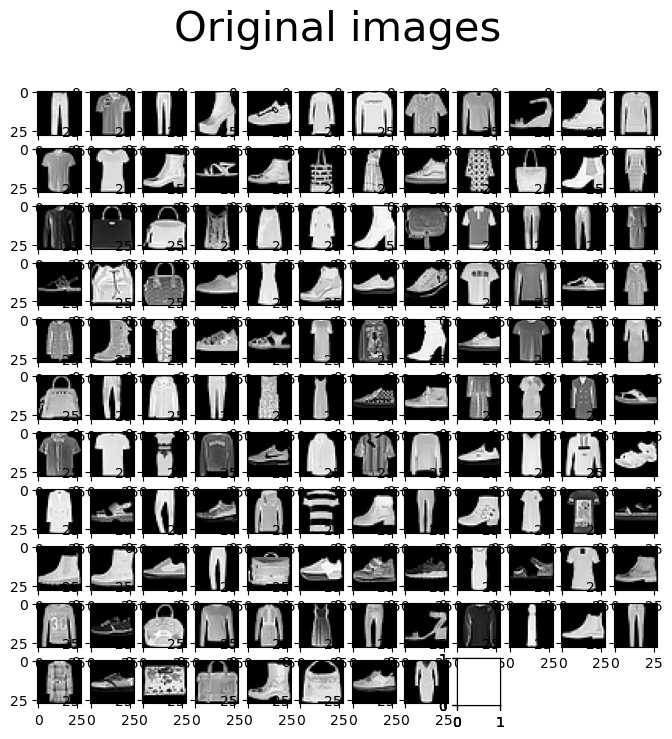

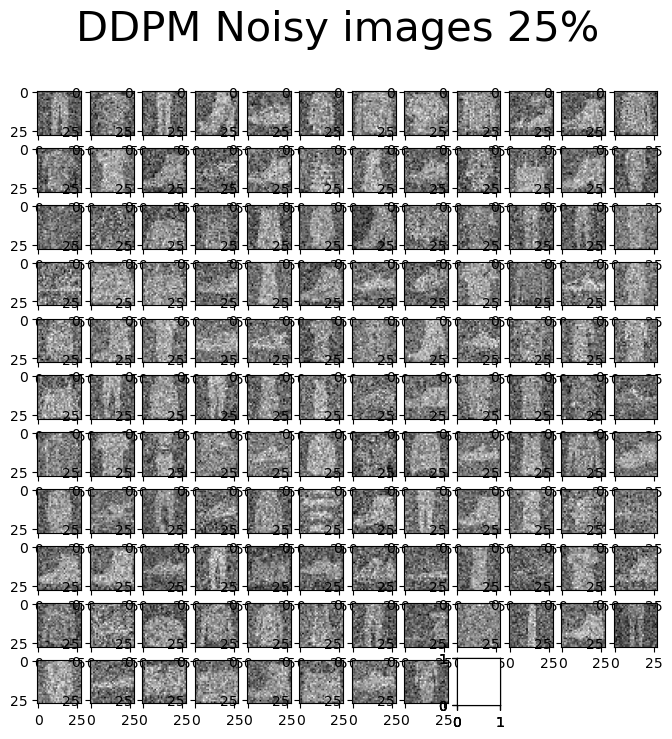

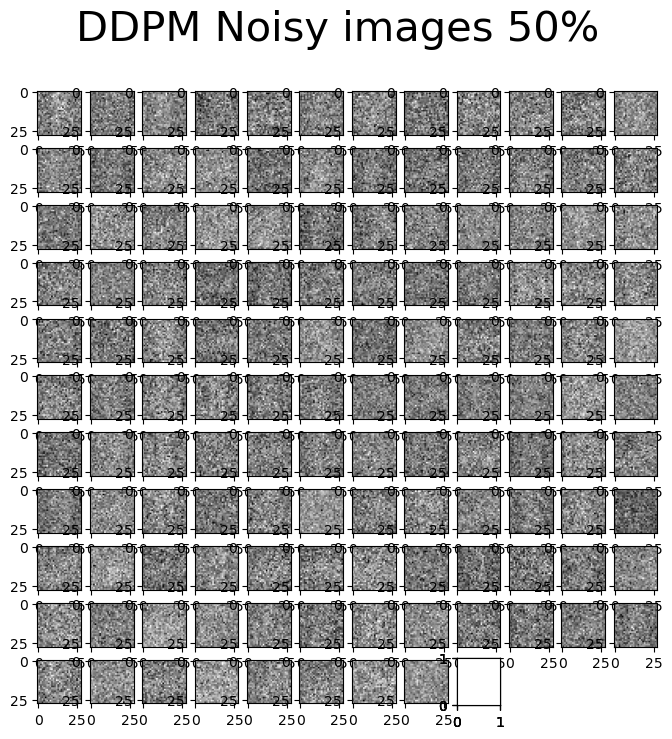

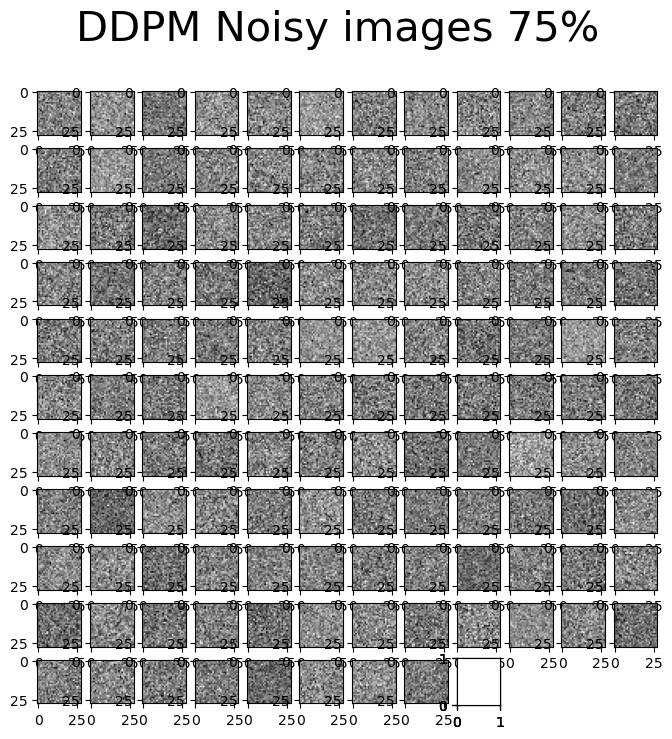

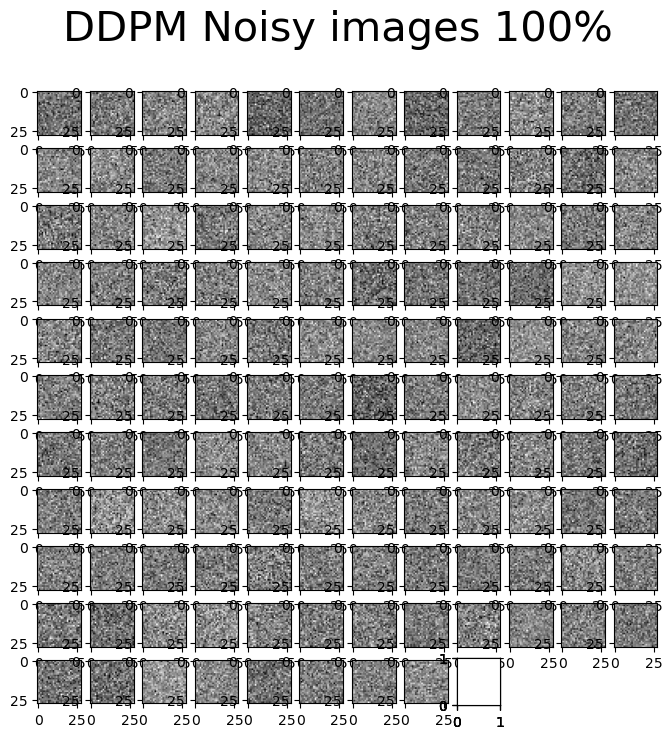

In [22]:
# Optionally, show the diffusion (forward) process
show_forward(ddpm, train_loader, device)

  0%|          | 0/1000 [00:00<?, ?it/s]

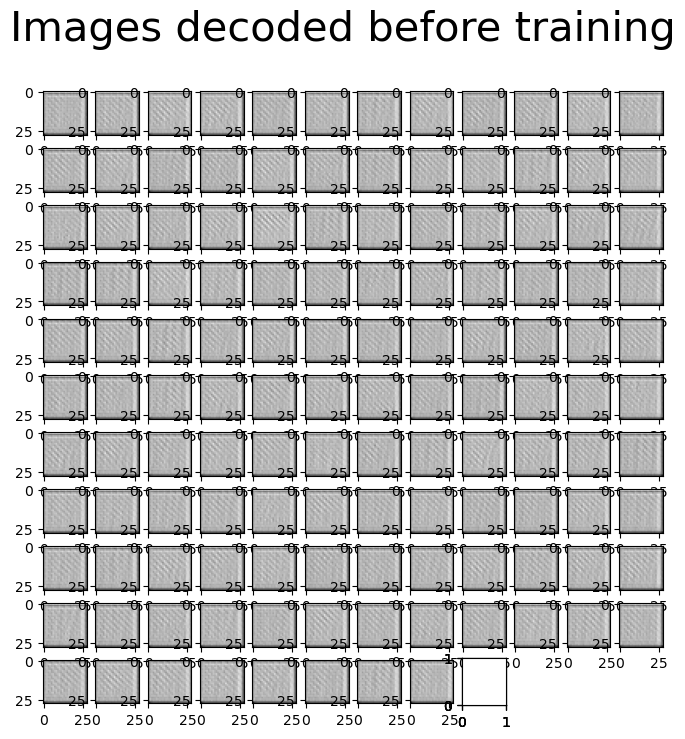

In [23]:
# Optionally, show the denoising (backward) process
train_decoded = decode_data(ddpm, train_loader, gif_name="before_training.gif", subset=True)
show_images(train_decoded, "Images decoded before training")

In [24]:
print(train_decoded.shape)
del train_decoded

torch.Size([128, 1, 28, 28])


# Training loop

In [25]:
# Training

if train_flag:
    training_loop(ddpm, train_loader, n_epochs, optim=Adam(ddpm.parameters(), lr), device=device, model_store_name=model_store_name)

Epoch 1/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 1: 0.187 --> Best model ever (stored)


Epoch 2/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 2: 0.046 --> Best model ever (stored)


Epoch 3/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 3: 0.035 --> Best model ever (stored)


Epoch 4/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 4: 0.030 --> Best model ever (stored)


Epoch 5/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 5: 0.025 --> Best model ever (stored)


Epoch 6/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 6: 0.023 --> Best model ever (stored)


Epoch 7/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 7: 0.022 --> Best model ever (stored)


Epoch 8/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 8: 0.021 --> Best model ever (stored)


Epoch 9/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 9: 0.020 --> Best model ever (stored)


Epoch 10/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 10: 0.019 --> Best model ever (stored)


Epoch 11/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 11: 0.018 --> Best model ever (stored)


Epoch 12/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 12: 0.018 --> Best model ever (stored)


Epoch 13/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 13: 0.017 --> Best model ever (stored)


Epoch 14/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 14: 0.016 --> Best model ever (stored)


Epoch 15/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 15: 0.015 --> Best model ever (stored)


Epoch 16/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 16: 0.015 --> Best model ever (stored)


Epoch 17/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 17: 0.014 --> Best model ever (stored)


Epoch 18/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 18: 0.014 --> Best model ever (stored)


Epoch 19/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 19: 0.014 --> Best model ever (stored)


Epoch 20/20:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 20: 0.013 --> Best model ever (stored)


# Evaluating the model

In [26]:
# Loading the trained model
best_model = Cond_DDPM(denoising_UNet(n_steps), n_steps=n_steps, min_beta=min_beta, max_beta=max_beta, device=device)
best_model.load_state_dict(torch.load('../model/{}.pt'.format(model_store_name), weights_only=True))
best_model.eval()
print("Model loaded")

Model loaded


Decoding training images


  0%|          | 0/1000 [00:00<?, ?it/s]

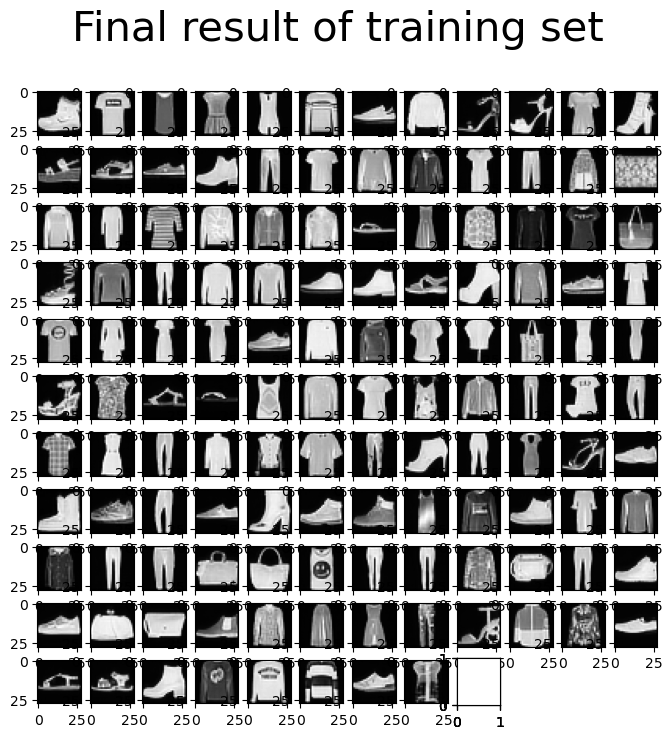

In [27]:
print("Decoding training images")
train_decoded = decode_data(
    best_model,
    eval_train_loader,
    train_num,
    batch_size,
    device=device,
    gif_name="conditional_fashion_training_set_first_100.gif",
    subset=True
    )

show_images(train_decoded, "Final result of training set")

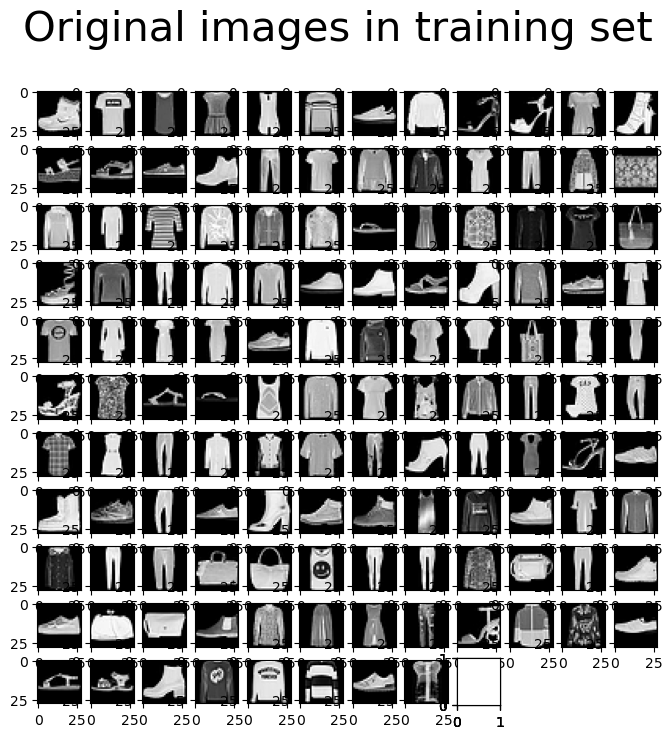

In [32]:
show_first_batch(eval_train_loader, 'Original images in training set')

Decoding test images


  0%|          | 0/1000 [00:00<?, ?it/s]

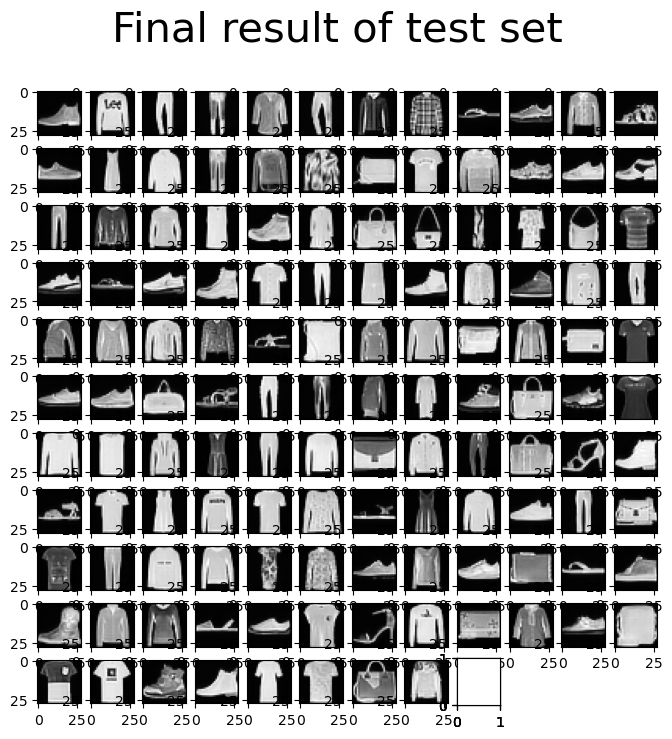

In [28]:
print("Decoding test images")
test_decoded = decode_data(
    best_model,
    eval_test_loader,
    train_num,
    batch_size,
    device=device,
    gif_name="conditional_fashion_test_set_first_100.gif",
    subset=True
    )

show_images(test_decoded, "Final result of test set")

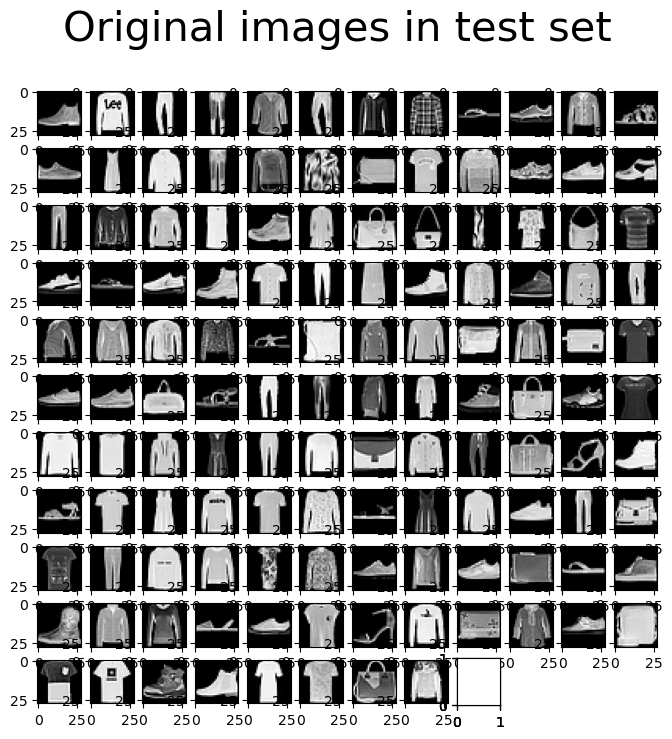

In [33]:
show_first_batch(eval_test_loader, 'Original images in test set')

# PSNR evaluation on training and test sets

In [35]:
train_decoded_out = train_decoded.clone()

for i in range(len(train_decoded_out)):
    train_decoded_out[i] -= torch.min(train_decoded_out[i])
    train_decoded_out[i] *= 255 / torch.max(train_decoded_out[i])

train_decoded_out.shape, train_decoded_out.max(), train_decoded_out.min()

(torch.Size([128, 1, 28, 28]),
 tensor(255.0000, device='cuda:0'),
 tensor(0., device='cuda:0'))

In [36]:
test_decoded_out = test_decoded.clone()

for i in range(len(test_decoded_out)):
    test_decoded_out[i] -= torch.min(test_decoded_out[i])
    test_decoded_out[i] *= 255 / torch.max(test_decoded_out[i])

test_decoded_out.shape, test_decoded_out.max(), test_decoded_out.min()

(torch.Size([128, 1, 28, 28]),
 tensor(255.0000, device='cuda:0'),
 tensor(0., device='cuda:0'))

In [37]:
train_decoded_out = train_decoded_out.cpu().numpy().astype(np.uint8)
test_decoded_out = test_decoded_out.cpu().numpy().astype(np.uint8)
print(train_decoded_out.shape, np.max(train_decoded_out), np.min(train_decoded_out))
print(test_decoded_out.shape, np.max(test_decoded_out), np.min(test_decoded_out))

(128, 1, 28, 28) 255 0
(128, 1, 28, 28) 255 0


In [62]:
def PSNR(original, compressed): 
    mse = np.mean((original - compressed) ** 2) 
    if(mse == 0):  # MSE is zero means no noise is present in the signal . 
                  # Therefore PSNR have no importance. 
        return 100
    max_pixel = 255.0
    psnr = 20 * math.log10(max_pixel / math.sqrt(mse)) 
    return psnr

In [54]:
training_set = dataset.data.numpy()[:batch_size].reshape(batch_size,1,28,28)
test_set = test_dataset.data.numpy()[:batch_size].reshape(batch_size,1,28,28)
print(training_set.shape, np.max(training_set), np.min(training_set))
print(test_set.shape, np.max(test_set), np.min(test_set))

(128, 1, 28, 28) 255 0
(128, 1, 28, 28) 255 0


In [63]:
# Training set PSNR - First batch
PSNR(training_set, train_decoded_out)

31.9667059967664

In [68]:
# Test set PSNR - First batch
PSNR(test_set, test_decoded_out)

31.818671542282658

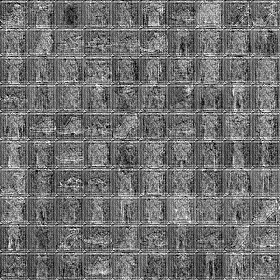

In [66]:
from IPython.display import Image

Image(open('conditional_fashion_training_set_first_100.gif','rb').read())

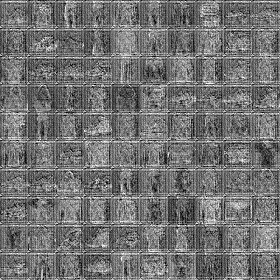

In [67]:
Image(open('conditional_fashion_test_set_first_100.gif','rb').read())